# Importing Libraries 

In [1]:
import numpy as np
import pandas as pd
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder

                          

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

plt.style.use('ggplot')
%matplotlib inline
np.set_printoptions(suppress=True) # Suppress scientific notation where possible

In [3]:
from sklearn import datasets
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split


# Data Cleaning

In [24]:
df_list = pd.read_csv('listings.csv', index_col=0)
df_list2 = pd.read_csv('listings-3.csv', index_col=0)
df_list3 = pd.read_csv('listings-4.csv', index_col=0)
#df_hoods = pd.read_csv('neighbourhoods.csv', index_col=0)
#df_reviews = pd.read_csv('reviews-2.csv', index_col=0)
# import re
# price of listing on a given night converted to float
test_df = df_list
df_list['price_n']=df_list['price'].str.extract(r'(\d+)')
df_list['price_n'] = pd.to_numeric(df_list['price_n'],errors='coerce')
#df_price = test_df.groupby(by='listing_id').sum()
#combined = pd.concat([df_list, df_price], axis=1)

/Users/jihyangseo/Desktop/GitGoods/miniconda3/envs/metis/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning: Columns (61,62,94,95) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [26]:
df_list.columns

Index(['listing_url', 'scrape_id', 'last_scraped', 'name', 'description',
       'neighborhood_overview', 'picture_url', 'host_id', 'host_url',
       'host_name', 'host_since', 'host_location', 'host_about',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_thumbnail_url', 'host_picture_url',
       'host_neighbourhood', 'host_listings_count',
       'host_total_listings_count', 'host_verifications',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'neighbourhood_cleansed', 'neighbourhood_group_cleansed', 'latitude',
       'longitude', 'property_type', 'room_type', 'accommodates', 'bathrooms',
       'bathrooms_text', 'bedrooms', 'beds', 'amenities', 'price',
       'minimum_nights', 'maximum_nights', 'minimum_minimum_nights',
       'maximum_minimum_nights', 'minimum_maximum_nights',
       'maximum_maximum_nights', 'minimum_nights_avg_ntm',
       'maximum_nights_avg_ntm', 'calendar_updated',

In [27]:
fin = test_df[['availability_365', 'price_n','amenities','host_is_superhost','room_type','accommodates',
                'bedrooms','beds','number_of_reviews_ltm',
                'number_of_reviews_l30d','review_scores_rating','review_scores_accuracy',
                'review_scores_cleanliness','review_scores_checkin','review_scores_communication',
                'review_scores_location','host_total_listings_count',
                'review_scores_value','neighbourhood']]

#'latitude','longitude'
#'property_type'
indexNames = fin[fin['availability_365'] ==0].index
fin.drop(indexNames, inplace=True)

/Users/jihyangseo/Desktop/GitGoods/miniconda3/envs/metis/lib/python3.8/site-packages/pandas/core/frame.py:4305: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


In [28]:
fin.neighbourhood.unique()

array(['New York, United States', 'Brooklyn, New York, United States',
       nan, 'Queens, New York, United States',
       'Long Island City, New York, United States',
       'Astoria, New York, United States',
       'Staten Island, New York, United States',
       'Bronx, New York, United States',
       'Rockaway Beach, New York, United States',
       'Long Island , New York, United States',
       'Elmhurst, New York, United States',
       'Riverdale , New York, United States',
       'Kips Bay, New York, United States',
       'Jackson Heights, New York, United States',
       'New York, Manhattan, United States',
       'Brooklyn , New York, United States',
       'Flushing, New York, United States',
       'Astoria , New York, United States',
       'Bushwick, Brooklyn, New York, United States',
       'Sunnyside , New York, United States',
       'Bushwick, New York, United States',
       'LONG ISLAND CITY, New York, United States',
       'Astoria, Queens, New York, Unite

In [29]:
fin.availability_365.describe()

count    22080.000000
mean       224.252899
std        127.415227
min          1.000000
25%         90.000000
50%        239.000000
75%        360.000000
max        365.000000
Name: availability_365, dtype: float64

In [30]:
#fin['target'] = (fin['availability_365'] >= fin['availability_365'].median()).astype(int)
fin['target'] = (fin['availability_365'] >= 200).astype(int)

<ipython-input-30-45afb6bab6dc>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fin['target'] = (fin['availability_365'] >= 200).astype(int)


In [31]:
fin.target.value_counts()

1    11522
0    10558
Name: target, dtype: int64

In [32]:
fin = fin[['target',  'price_n','host_is_superhost','room_type','accommodates',
                'bedrooms','beds','number_of_reviews_ltm',
                'number_of_reviews_l30d','review_scores_rating','review_scores_accuracy',
                'review_scores_cleanliness','review_scores_checkin','review_scores_communication',
                'review_scores_location','host_total_listings_count',
                'review_scores_value']]
#'availability_365',

In [33]:
import re

def str_to_list(inputString):
    return re.findall(r'(?<=")[\s\w]+', inputString)

def find_amenities(inputString):
    return re.findall(r'((?<=")washer|wifi|air conditioning|tv|fireplace|gym|pool|(?<=free street)[\s\w]+parking|balcony)', inputString, flags=re.IGNORECASE)

# df_list['amenities_list'] = df_list['amenities'].apply(str_to_list)

df_list['amenities_list'] = df_list['amenities'].str.lower().apply(find_amenities)

In [34]:
from sklearn.preprocessing import MultiLabelBinarizer

# mlb = MultiLabelBinarizer(sparse_output=True)
mlb = MultiLabelBinarizer()

# df_list = df_list.join(pd.DataFrame.sparse.from_spmatrix(mlb.fit_transform(df_list['amenities_list'], index=df_list.index, columns=mlb.classes_))
fin = fin.join(pd.DataFrame(mlb.fit_transform(df_list['amenities_list']), columns=mlb.classes_, index=df_list.index))

In [35]:
pd.set_option('display.max_colwidth', -1)

<ipython-input-35-0891b765a168>:1: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('display.max_colwidth', -1)


In [36]:
re.findall(r'(?<=free ).*parking','"Free street parking"', flags=re.IGNORECASE)

['street parking']

In [37]:
#print(fin.neighbourhood.value_counts())
#numeric_features=[]
#numeric_transfomer=
#categorical_transformer=OneHotEncoder(handle_unknown='error',drop='first')

#preprocessor
fin_dummies = pd.get_dummies(fin)


In [38]:
fin_dummies.dropna()

,target,price_n,accommodates,bedrooms,beds,number_of_reviews_ltm,number_of_reviews_l30d,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,...,pool,tv,washer,wifi,host_is_superhost_f,host_is_superhost_t,room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room
id,,,,,,,,,,,,,,,,,,,,,
3831,1,74,3,1.0,3.0,77,4,89.0,9.0,9.0,...,0,1,0,1,1,0,1,0,0,0
5121,1,60,2,1.0,1.0,0,0,90.0,8.0,8.0,...,0,0,0,1,1,0,0,0,1,0
5803,1,89,2,1.0,0.0,6,0,94.0,10.0,10.0,...,0,0,1,1,0,1,0,0,1,0
6990,1,62,1,1.0,1.0,0,0,98.0,10.0,10.0,...,0,0,0,1,1,0,0,0,1,0
7097,1,199,2,1.0,1.0,21,3,97.0,10.0,10.0,...,0,1,1,1,0,1,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46794411,1,70,3,1.0,1.0,1,1,100.0,10.0,10.0,...,0,1,0,1,1,0,0,0,1,0
46814801,0,77,2,1.0,1.0,1,1,100.0,10.0,10.0,...,0,0,1,0,1,0,0,0,1,0
46829853,0,99,3,1.0,1.0,1,1,100.0,10.0,10.0,...,0,1,0,1,1,0,0,0,1,0


In [39]:
fin_dummies.dropna(axis=0,inplace=True)

# Train Test Split 

In [40]:
fin_na = fin_dummies.fillna(fin_dummies.mean())

In [41]:
fin_na.columns

Index(['target', 'price_n', 'accommodates', 'bedrooms', 'beds',
       'number_of_reviews_ltm', 'number_of_reviews_l30d',
       'review_scores_rating', 'review_scores_accuracy',
       'review_scores_cleanliness', 'review_scores_checkin',
       'review_scores_communication', 'review_scores_location',
       'host_total_listings_count', 'review_scores_value', ' parking',
       'air conditioning', 'balcony', 'fireplace', 'gym', 'pool', 'tv',
       'washer', 'wifi', 'host_is_superhost_f', 'host_is_superhost_t',
       'room_type_Entire home/apt', 'room_type_Hotel room',
       'room_type_Private room', 'room_type_Shared room'],
      dtype='object')

In [42]:
y = fin_na.iloc[:,0]
X = fin_na.iloc[:,1:]


In [43]:
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, random_state=42)

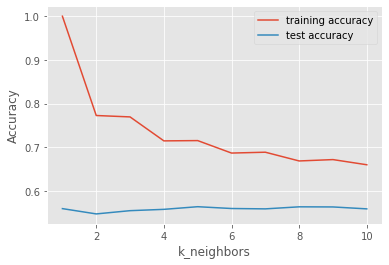

In [44]:

training_accuracy = []
test_accuracy = []
# try n_neighbors from 1 to 10
neighbors_settings = range(1, 11)
for n_neighbors in neighbors_settings:
    # build the model
    clf = KNeighborsClassifier(n_neighbors=n_neighbors)
    clf.fit(X_train, y_train)
    # record training set accuracy
    training_accuracy.append(clf.score(X_train, y_train))
    # record generalization accuracy
    test_accuracy.append(clf.score(X_test, y_test))
    
plt.plot(neighbors_settings, training_accuracy, label="training accuracy")
plt.plot(neighbors_settings, test_accuracy, label="test accuracy")
plt.ylabel("Accuracy")
plt.xlabel("k_neighbors")
plt.legend()


In [77]:
fin_na.to_csv("abnb.csv")

In [45]:
tree = DecisionTreeClassifier(max_depth=4, random_state=0)
tree.fit(X_train, y_train)
print("Accuracy on training set: {:.3f}".format(tree.score(X_train, y_train)))
print("Accuracy on test set: {:.3f}".format(tree.score(X_test, y_test)))

NameError: name 'DecisionTreeClassifier' is not defined

In [ ]:
# X_train.info()
# np.any(np.isnan(X_train))
# np.all(np.isfinite(X_train))

is_NaN = X_train.isnull()
row_has_NaN = is_NaN.any(axis=1)
rows_with_NaN = X_train[row_has_NaN]
rows_with_NaN

In [ ]:
from sklearn.naive_bayes import GaussianNB
nb = GaussianNB()
nb.fit(X_train, y_train)
nb.score(X_test, y_test)

In [ ]:
nb.theta_

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)
logreg = LogisticRegression()
logreg.fit(X_train, y_train)
print("Test score: {:.2f}".format(logreg.score(X_test, y_test)))


In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
rf = RandomForestClassifier(n_estimators=100, random_state=13)
cross_val_score(rf, X_train, y_train, scoring='recall')


# KNN

In [48]:
from __future__ import print_function

In [49]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics
knn = KNeighborsClassifier(n_neighbors=5)
knn.fit(X, y)
y_pred = knn.predict(X)


print(metrics.accuracy_score(y, y_pred))

0.9991752577319588


In [50]:
knn = KNeighborsClassifier(n_neighbors=5)
knn.fit(X_train, y_train)
print("The score for kNN is")
print("Training: {:6.2f}%".format(100*knn.score(X_train, y_train)))
print("Test set: {:6.2f}%".format(100*knn.score(X_test, y_test)))

The score for kNN is
Training:  99.91%
Test set:  99.84%


In [51]:
from sklearn.model_selection import GridSearchCV
knn_grid = GridSearchCV(estimator = KNeighborsClassifier(),
                        param_grid = {'n_neighbors': np.arange(1,20)}, cv=5)

In [52]:
knn_grid.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=KNeighborsClassifier(),
             param_grid={'n_neighbors': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19])})

In [53]:
knn_grid.best_params_

{'n_neighbors': 5}

In [63]:
logit = LogisticRegression(C = 0.95)
logit.fit(X_train, y_train)
print("The score for logistic regression is")
print("Training: {:6.2f}%".format(100*logit.score(X_train, y_train)))
print("Test set: {:6.2f}%".format(100*logit.score(X_test, y_test)))

The score for logistic regression is
Training:  99.18%
Test set:  98.85%


/Users/jihyangseo/Desktop/GitGoods/miniconda3/envs/metis/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [ ]:
# # Let's do a prediction of the first 5 observations from logistic

# logit.predict_proba(X_test[:5,])

In [ ]:
# from sklearn.metrics import confusion_matrix

# print("kNN confusion matrix: \n\n", confusion_matrix(label_test, knn.predict(X_test)))

In [49]:
import folium
from IPython.core.display import display, HTML

def folium_deepnote_show(m):
    data = m.get_root().render()
    data_fixed_height = data.replace('width: 100%;height: 100%', 'width: 100%').replace('height: 100.0%;', 'height: 609px;', 1)
    display(HTML(data_fixed_height))


newyork_map = folium.Map(location=[40.7723747, -73.9733599], zoom_start=12, )

for lat, lng, label in zip(df_list.latitude, df_list.longitude, df_list.room_type):
    if label=='Hotel room':
        folium.features.CircleMarker(
            [lat, lng],
            radius=1,
            color='orange',
            fill=True,
            popup=label,
            fill_color='darkred',
            fill_opacity=0.6
        ).add_to(newyork_map)
    elif label=='Shared room':
        folium.features.CircleMarker(
            [lat, lng],
            radius=1,
            color='green',
            fill=True,
            popup=label,
            fill_color='darkred',
            fill_opacity=0.6
        ).add_to(newyork_map)
    elif label=='Entire home/apt':
        folium.features.CircleMarker(
            [lat, lng],
            radius=1,
            color='red',
            fill=True,
            popup=label,
            fill_color='darkred',
            fill_opacity=0.6
        ).add_to(newyork_map)
    elif label=='Private room':
        folium.features.CircleMarker(
            [lat, lng],
            radius=1,
            color='blue',
            fill=True,
            popup=label,
            fill_color='darkred',
            fill_opacity=0.6
        ).add_to(newyork_map)

#Display map
folium_deepnote_show(newyork_map)

<a style='text-decoration:none;line-height:16px;display:flex;color:#5B5B62;padding:10px;justify-content:end;' href='https://deepnote.com?utm_source=created-in-deepnote-cell&projectId=4086fe69-2c37-4237-bd14-7bce1d182b1a' target="_blank">
 </img>
Created in <span style='font-weight:600;margin-left:4px;'>Deepnote</span></a>